In [1]:
import math
import numpy as np
from tabulate import tabulate
import matplotlib.pyplot as plt
from IPython.display import HTML
import tables
import pandas as pd
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
# Diketahui
massa = 0.15 #Berat peluru
v0 = 50 #Kecepatan awal
angle = 35 #Sudut
angle_rad = (angle/360) * (2 * np.pi) #Untuk mengubah sudut ke radian
dt = 0.01 #Konstanta Waktu
g = 9.806 #Gravitasi
d = 0.0013 #Konstanta Hambatan
t = 0 #Waktu awal


In [3]:
# Rumus
vx = v0 * np.cos(angle_rad) #Mencari kecepatan awal sumbu X (Garis Horizontal di grafik)
vy = v0 * np.sin(angle_rad)
vy1 = v0 * np.sin(angle_rad) #Mencari kecepatan awal sumbu y (Garis Untuk Lintasan Parabola (y))
ax = 0 #Percepatan Gravitasi pada sumbu X 
ay = -g #Percepatan Gravitasi pada sumbu Y 

# Rumus Untuk Analitik (Tanpa Hambatan)
# time (Mencari waktu total)
tTotal = (2 * v0 * np.sin(angle_rad)) / g
# range (Jarak)
JarakX = v0 * np.cos(angle_rad) * tTotal
# max height (Ketinggian)
HMax = (v0**2 * np.sin(angle_rad)**2) / (-2 * ay)


#Numerik Tanpa Hambatan

Penjelasan Rumus Update Numerik untuk X

Vx = V0 . Cos Teta						
   = 50 . Cos 35 							
   = 40.957							      

X(0) = 0 + Vx . Delta T				
     = 0 + 40.957 * 0.01			
     = 0.40957							  

X(0,01) = x(0) + Vx . Delta T				
       = 0.40957 + 0.40957						
       = 0.8191							                 

X(0,02) = x(0,01) + Vx . Delta T			
       = 0.8191 + 0.40957						  
       = 1.2286
       

X(5,83)	= x(5,82) + vx * delta T
        = 238,7828 + 0.40957						 
        = 239,1923							        



Penjelasan untuk Vy dan Y

Vy0 = V0.sin teta = 50.sin35 = 28,678

V(0) = Vy0 + (ay==(-g)) * dt = 28,678 + (-9.806) * 0,01 = 28,5799

Y(0) = 0 + V(0) * dt = 0 + 28,579 * 0,01 = 0,2858

V(0,01) = V(0) + ay * dt = 28,5799 + (-9.806) * 0.01 = 28,4818

Y(0,01) = Y(0) + V(0,01) * dt = 0,2858 + 28,4818 * 0,01 = 0,5706

V(0,02) = V(0,01) + ay * dt = 28.4818 + (-9.806) * 0,01 = 28.3837

Y(0,02) = Y(0,01) + V(0,02) * dt = 0,5706 + 28.3837 * 0.01 = 


a(vy) + b(y) = b
a1(vy1) = a(vy)

In [4]:
vx

40.95760221444959

In [5]:
vy

28.678821817552304

In [6]:
t

0

In [7]:
def numeric_TH(t,vx,vy,vy1):
  arr_X = [] #Membuat variable untuk menampung array dari nilai X (jarak)
  arr_Y = [] #Membuat variable untuk menampung array dari nilai Y (ketinggian)
  arr_T = [] #Membuat variable untuk menampung array dari nilai T (waktu)
  arr_vy = []
  x = 0 #Posisi awal 
  y = 0 #Posisi awal
  
  #start (t) adalah nilai waktu awal.
  #stop(tTotal+dt) adalah waktu terakhir dari nilai t sebelumnya, selanjutnya ditambahkan dengan nilai dt.
  #step (dt) adalah angka yang menentukan jarak (perbedaan) antara setiap dua nilai berurutan .

  #t = 0 , tTotal + dt = 0 + 0,01 = 0,01, dt = 0,01
  #t = 0.01 , tTotal + dt = 0.01 + 0.01 = 0.02, dt = 0.01
  #t = 0.02 , tTotal + dt = 0.02 + 0.01 = 0.03, dt = 0.01

  #t = 0,03
  #tTotal + dt = 0,03 + 0,01= 0,04

  for t in np.arange(t,tTotal+dt,dt): #Jika t ada didalam range
    x = x + (vx * dt) #x(t+dt) = x(t+dt) + vx . dt
    vy1 = vy1 + (ay * dt) #vy(t+dt) = vy(t+dt) + -g * dt
    vy = vy + (ay * dt) #vy(t+dt) = vy(t+dt) + -g * dt
    y = y + (vy * dt) #y(t+dt) = y(t+dt) + vy . dt
    arr_X.append(x)
    arr_Y.append(y)
    arr_T.append(t)
    arr_vy.append(vy1)
    
    if (y<0):
      break
            
  return arr_T,arr_X,arr_Y, arr_vy


In [8]:
print('           Tabel Numerik          ')
print('==================================')
t1,x1,y1,y2 = numeric_TH(t,vx,vy,vy1)
tab_Num_TH = pd.DataFrame((zip(t1, x1, y1, y2)), columns=['Waktu T', 'Jarak X', 'Tinggi Y', 'Update VY'])
print(tab_Num_TH)

           Tabel Numerik          
     Waktu T     Jarak X  Tinggi Y  Update VY
0       0.00    0.409576  0.285808  28.580762
1       0.01    0.819152  0.570635  28.482702
2       0.02    1.228728  0.854481  28.384642
3       0.03    1.638304  1.137347  28.286582
4       0.04    2.047880  1.419232  28.188522
..       ...         ...       ...        ...
579     5.79  237.554093  1.115873 -28.195978
580     5.80  237.963669  0.832932 -28.294038
581     5.81  238.373245  0.549011 -28.392098
582     5.82  238.782821  0.264110 -28.490158
583     5.83  239.192397 -0.021773 -28.588218

[584 rows x 4 columns]


In [30]:
print (tabulate(tab_Num_TH,tablefmt="github",headers= ["t","x(t)","y(t)","vy(t)"]))

|     |    t |       x(t) |       y(t) |       vy(t) |
|-----|------|------------|------------|-------------|
|   0 | 0    |   0.409576 |  0.285808  |  28.5808    |
|   1 | 0.01 |   0.819152 |  0.570635  |  28.4827    |
|   2 | 0.02 |   1.22873  |  0.854481  |  28.3846    |
|   3 | 0.03 |   1.6383   |  1.13735   |  28.2866    |
|   4 | 0.04 |   2.04788  |  1.41923   |  28.1885    |
|   5 | 0.05 |   2.45746  |  1.70014   |  28.0905    |
|   6 | 0.06 |   2.86703  |  1.98006   |  27.9924    |
|   7 | 0.07 |   3.27661  |  2.259     |  27.8943    |
|   8 | 0.08 |   3.68618  |  2.53697   |  27.7963    |
|   9 | 0.09 |   4.09576  |  2.81395   |  27.6982    |
|  10 | 0.1  |   4.50534  |  3.08995   |  27.6002    |
|  11 | 0.11 |   4.91491  |  3.36497   |  27.5021    |
|  12 | 0.12 |   5.32449  |  3.63901   |  27.404     |
|  13 | 0.13 |   5.73406  |  3.91207   |  27.306     |
|  14 | 0.14 |   6.14364  |  4.18415   |  27.2079    |
|  15 | 0.15 |   6.55322  |  4.45525   |  27.1099    |
|  16 | 0.

Pendekatan Numerik


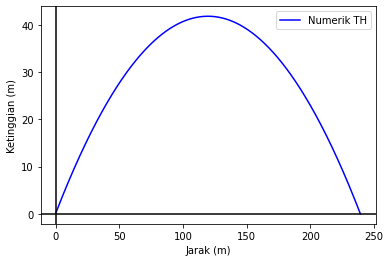

VY =  28.678821817552304
VX =  40.95760221444959
Jarak X Max =  239.192396932388
Tinggi Y Max =  41.79405290725263
Waktu T Max =  5.83
Jika dibulatkan 2 angka dibelakang koma :
VY = 28.678822
VX = 40.957602
Jarak X Max = 239.19
Tinggi Y Max = 41.79
Waktu T Max = 5.83


In [10]:
N1,N2,N3,N4,N5 = x1,y1,t1,vy,vx
print("Pendekatan Numerik")
# plt.figure()
plt.plot(N1,N2, c='b', label='Numerik TH')
plt.axhline(c='black')
plt.axvline(c='black')
plt.xlabel('Jarak (m)')
plt.ylabel('Ketinggian (m)')
plt.legend()
plt.show()
print('VY = ', (N4))
print('VX = ', (N5))
print('Jarak X Max = ', (max(N1)))
print('Tinggi Y Max = ', (max(N2)))
print('Waktu T Max = ',(max(N3)))
print('==========================================')
print('Jika dibulatkan 2 angka dibelakang koma :')
print('VY = {:2f}'.format(N4))
print('VX = {:2f}'.format(N5))
print("Jarak X Max = {:.2f}".format(max(N1)))
print("Tinggi Y Max = {:.2f}".format(max(N2)))
print("Waktu T Max = {:.2f}".format(max(N3)))


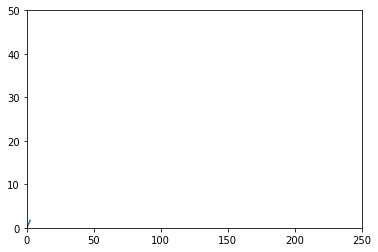

In [11]:
###Simulasi Numerik Tanpa Hambatan
fig, ax = plt.subplots()

NumX = np.asarray(N1)
NumY = np.asarray(N2)                              
ttime = np.arange(0, 0.1, 0.01)
line, = ax.plot(ttime, vy * ttime - (0.5) * -1*g * ttime * ttime)   

def animate(i):
    line.set_xdata(NumX[0:i+5])
    line.set_ydata(NumY[0:i+5])  
    return line,

plt.axis([0, 250, 0, 50])
ax.set_autoscale_on(False)

ani = animation.FuncAnimation(fig, animate, np.arange(1, 584))

HTML(ani.to_jshtml())

#Analitik Tanpa Hambatan

y(0) = (0,5 * (-9,8) * 0 *0) + (28,678 * 0)
y(0,01) = (0,5 * (-9,8) * 0,01 * 0,01) + (28,678 * 0,01) = 

In [12]:
vy

28.678821817552304

In [13]:
vx

40.95760221444959

In [14]:
def analytic_TH(t,vx,vy):
  arr_X = []
  arr_Y = []
  arr_T = [] #buat array waktu
  x = 0
  y = 0
  
  #Untuk rumus Analitik berbeda dengan Numerik, jika Numerik rekursif sedangkan analitik tidak.
  #Pada Numerik : Jika ingin mengetahui nilai ketika t=0.3 , berarti kita harus mengetahui terlebih dahulu nilai t=0.2
  #Pada anlitik : Jika kita ingin mengetahui nilai t = 0.3, maka tidak harus menggunakan nilai pada t sebelumnya
  for t in np.arange(t,tTotal+dt,dt):
    x = vx * t #t=0 => x(0) = vx * 0 = 0 // x(t) = vx * t
    #t = 0.02 => x(0,02) = vx * 0,02 =  
    y = (0.5 * ay * t * t) + (vy * t) #y=0 => y(0) = (0.5 * (-g) * 0 * 0) + (vy * 0) // y(t) = (0.5*t*t) + (vy*t)
    arr_X.append(x)
    arr_Y.append(y)
    arr_T.append(t)
    if (y<0):
      break

  return arr_T,arr_X,arr_Y

In [15]:
print('          Tabel Analitik          ')
print('==================================')
t1,x1,y1 = analytic_TH(t,vx,vy)
tab_analytic_TH = pd.DataFrame(list(zip(t1,x1,y1)), columns=['Waktu T','Jarak X', 'Tinggi Y'])
print(tab_analytic_TH)

          Tabel Analitik          
     Waktu T     Jarak X  Tinggi Y
0       0.00    0.000000  0.000000
1       0.01    0.409576  0.286298
2       0.02    0.819152  0.571615
3       0.03    1.228728  0.855952
4       0.04    1.638304  1.139308
..       ...         ...       ...
581     5.81  237.963669  1.117796
582     5.82  238.373245  0.834366
583     5.83  238.782821  0.549954
584     5.84  239.192397  0.264563
585     5.85  239.601973 -0.021810

[586 rows x 3 columns]


In [29]:
print (tabulate(tab_analytic_TH,tablefmt="github",headers= ["t","x(t)","y(t)"]))

|     |    t |       x(t) |       y(t) |
|-----|------|------------|------------|
|   0 | 0    |   0        |  0         |
|   1 | 0.01 |   0.409576 |  0.286298  |
|   2 | 0.02 |   0.819152 |  0.571615  |
|   3 | 0.03 |   1.22873  |  0.855952  |
|   4 | 0.04 |   1.6383   |  1.13931   |
|   5 | 0.05 |   2.04788  |  1.42168   |
|   6 | 0.06 |   2.45746  |  1.70308   |
|   7 | 0.07 |   2.86703  |  1.98349   |
|   8 | 0.08 |   3.27661  |  2.26293   |
|   9 | 0.09 |   3.68618  |  2.54138   |
|  10 | 0.1  |   4.09576  |  2.81885   |
|  11 | 0.11 |   4.50534  |  3.09534   |
|  12 | 0.12 |   4.91491  |  3.37086   |
|  13 | 0.13 |   5.32449  |  3.64539   |
|  14 | 0.14 |   5.73406  |  3.91894   |
|  15 | 0.15 |   6.14364  |  4.19151   |
|  16 | 0.16 |   6.55322  |  4.46309   |
|  17 | 0.17 |   6.96279  |  4.7337    |
|  18 | 0.18 |   7.37237  |  5.00333   |
|  19 | 0.19 |   7.78194  |  5.27198   |
|  20 | 0.2  |   8.19152  |  5.53964   |
|  21 | 0.21 |   8.6011   |  5.80633   |
|  22 | 0.22 |  

In [17]:
JarakX

239.5708292845983

Pendekatan Analitik


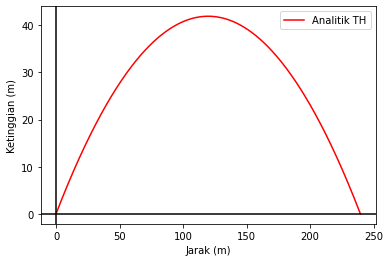

VY =  28.678821817552304
VX =  40.95760221444959
Jarak X Max =  239.5708292845983
Tinggi Y Max =  41.9373251500568
Waktu T Max =  5.84923961198293
Jika dibulatkan 2 angka dibelakang koma :
VY = 28.678822
VX = 40.957602
Jarak X Max = 239.57
Tinggi Y Max = 41.94
Waktu T Max = 5.85


In [18]:
A1,A2,A3,A4,A5 = x1,y1,t1,vy,vx 
print("Pendekatan Analitik")
plt.figure()
plt.plot(A1, A2, c='r', label='Analitik TH')
plt.axhline(c='black')
plt.axvline(c='black')
plt.xlabel('Jarak (m)')
plt.ylabel('Ketinggian (m)')
plt.legend()
plt.show()
print('VY = ', (A4))
print('VX = ', (A5))
print('Jarak X Max = ', (JarakX))
print('Tinggi Y Max = ', (HMax))
print('Waktu T Max = ',(tTotal))
print('==========================================')
print('Jika dibulatkan 2 angka dibelakang koma :')
print('VY = {:2f}'.format(A4))
print('VX = {:2f}'.format(A5))
print("Jarak X Max = {:.2f}".format(JarakX))
print("Tinggi Y Max = {:.2f}".format(HMax))
print("Waktu T Max = {:.2f}".format(tTotal))


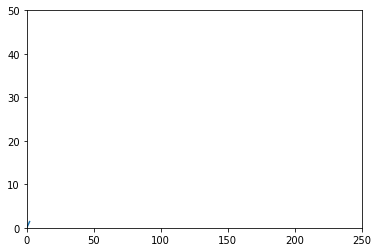

In [19]:
###Simulasi Analitik Tanpa Hambatan
fig, ax = plt.subplots()

AX = np.asarray(A1)
AY = np.asarray(A2)                              
ttime = np.arange(0, 0.1, 0.01)
line, = ax.plot(ttime, vy * ttime - (0.5) * -1*g * ttime * ttime)   

def animate(i):
    line.set_xdata(AX[0:i+5])
    line.set_ydata(AY[0:i+5])  
    return line,

plt.axis([0, 250, 0, 50])
ax.set_autoscale_on(False)

ani = animation.FuncAnimation(fig, animate, np.arange(1, 584))

HTML(ani.to_jshtml())

#Analitik dengan Hambatan

In [20]:
def analytic_DH(t,vx,vy):
  arr_X = []
  arr_Y = []
  arr_T = []
  x = 0
  y = 0

  for t in np.arange(t,tTotal+dt,dt):
    v = math.sqrt((vx*vx) + (vy*vy)) #49,999 = 50
    ax1 = -(d/massa) * v * vx #-17,747
    ay1 = ay - (d/massa) * v * vy #-22,232
    x = (vx * t) + (0.5 * ax1 * t * t) # t(0,01) = 0,4086
    #x(0,03) = (40.957 * 0,03) + (0.5 * -17,747 * 0.03 * 0.03) = 
    y = (vy * t) + (0.5 * ay1 * t * t) # y(0,01)
    #y(0.02) = (28.678 * 0.02) + (0.5 * -22.232 * 0.02^2) = 
    arr_X.append(x)
    arr_Y.append(y)
    arr_T.append(t)
    if (y<0):
      break

  return arr_T,arr_X,arr_Y
  

In [21]:
vx

40.95760221444959

In [22]:
vy

28.678821817552304

In [23]:
print('     Tabel Analitik Hambatan      ')
print('=================================')
t1,x1,y1 = analytic_DH(t,vx,vy)
tab_analytic_H = pd.DataFrame(list(zip(t1,x1, y1)), columns=['Waktu T', 'Jarak X', 'Jarak Y'])
print(tab_analytic_H)

     Tabel Analitik Hambatan      
     Waktu T    Jarak X   Jarak Y
0       0.00   0.000000  0.000000
1       0.01   0.408689  0.285677
2       0.02   0.815602  0.569130
3       0.03   1.220741  0.850360
4       0.04   1.624105  1.129366
..       ...        ...       ...
254     2.54  46.779862  1.123417
255     2.55  46.737744  0.844363
256     2.56  46.693851  0.563086
257     2.57  46.648183  0.279585
258     2.58  46.600741 -0.006139

[259 rows x 3 columns]


In [32]:
print (tabulate(tab_analytic_H,tablefmt="github",headers= ["t","x(t)","y(t)"]))

|     |    t |      x(t) |        y(t) |
|-----|------|-----------|-------------|
|   0 | 0    |  0        |  0          |
|   1 | 0.01 |  0.408689 |  0.285677   |
|   2 | 0.02 |  0.815602 |  0.56913    |
|   3 | 0.03 |  1.22074  |  0.85036    |
|   4 | 0.04 |  1.62411  |  1.12937    |
|   5 | 0.05 |  2.02569  |  1.40615    |
|   6 | 0.06 |  2.42551  |  1.68071    |
|   7 | 0.07 |  2.82355  |  1.95305    |
|   8 | 0.08 |  3.21981  |  2.22316    |
|   9 | 0.09 |  3.6143   |  2.49105    |
|  10 | 0.1  |  4.00702  |  2.75671    |
|  11 | 0.11 |  4.39796  |  3.02016    |
|  12 | 0.12 |  4.78712  |  3.28138    |
|  13 | 0.13 |  5.17452  |  3.54037    |
|  14 | 0.14 |  5.56013  |  3.79715    |
|  15 | 0.15 |  5.94397  |  4.0517     |
|  16 | 0.16 |  6.32604  |  4.30402    |
|  17 | 0.17 |  6.70633  |  4.55413    |
|  18 | 0.18 |  7.08485  |  4.80201    |
|  19 | 0.19 |  7.46159  |  5.04766    |
|  20 | 0.2  |  7.83655  |  5.29109    |
|  21 | 0.21 |  8.20975  |  5.5323     |
|  22 | 0.22 |  

In [25]:
max(x1)

47.2587245271316

Pendekatan Analitik Hambatan


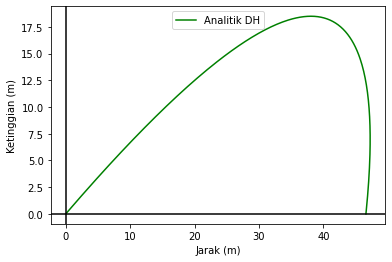

VY =  28.678821817552304
VX =  40.95760221444959
Jarak X Max =  47.2587245271316
Tinggi Y Max =  18.496305244214902
Waktu T Max =  2.58
Jika dibulatkan 2 angka dibelakang koma :
VY = 28.678822
VX = 40.957602
Jarak X Max = 47.26
Tinggi Y Max = 18.50
Waktu T Max = 2.58


In [26]:
AH1, AH2, AH3, AH4, AH5 = x1, y1, t1, vy, vx
print("Pendekatan Analitik Hambatan")
plt.figure()
plt.plot(AH1, AH2, c='g', label='Analitik DH')
plt.axhline(c='black')
plt.axvline(c='black')
plt.xlabel('Jarak (m)')
plt.ylabel('Ketinggian (m)')
plt.legend()
plt.show()
print('VY = ', (AH4))
print('VX = ', (AH5))
print('Jarak X Max = ', (max(AH1)))
print('Tinggi Y Max = ', (max(AH2)))
print('Waktu T Max = ',(max(AH3)))
print('==========================================')
print('Jika dibulatkan 2 angka dibelakang koma :')
print('VY = {:2f}'.format(A4))
print('VX = {:2f}'.format(A5))
print("Jarak X Max = {:.2f}".format(max(AH1)))
print("Tinggi Y Max = {:.2f}".format(max(AH2)))
print("Waktu T Max = {:.2f}".format(max(AH3)))

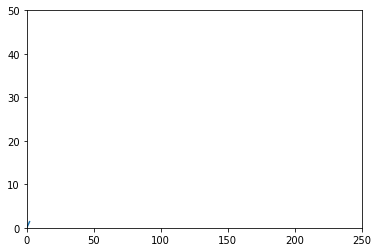

In [27]:
###Simulasi Analitik dengan Hambatan Udara
fig, ax = plt.subplots()

AHX = np.asarray(AH1)
AHY = np.asarray(AH2)                              
ttime = np.arange(0, 0.1, 0.01)
line, = ax.plot(ttime, vy * ttime - (0.5) * -1*g * ttime * ttime)   

def animate(i):
    line.set_xdata(AHX[0:i+5])
    line.set_ydata(AHY[0:i+5])  
    return line,

plt.axis([0, 250, 0, 50])
ax.set_autoscale_on(False)

ani = animation.FuncAnimation(fig, animate, np.arange(1, 584))

HTML(ani.to_jshtml())

# Kesimpulan

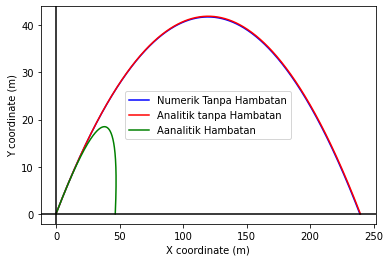

Numerik VS Analitik VS Analitik Hambatan

Tanpa Pembulatan Angka
Total waktu (s)     : Numerik: 5.83              || Analitik: 5.84923961198293  || Analitik Hambatan: 2.58
Jarak (m)           : Numerik: 239.192396932388  || Analitik: 239.5708292845983 || Analitik Hambatan: 47.2587245271316
Max Ketinggian (m)  : Numerik: 41.79405290725263 || Analitik: 41.9373251500568  || Analitik Hambatan: 18.496305244214902

Pembulatan 2 Angka Dibelakang Koma
Total waktu (s)     : Numerik: 5.83   || Analitik: 5.85    || Analitik Hambatan: 2.58
Jarak (m)           : Numerik: 239.19 || Analitik: 239.57  || Analitik Hambatan: 47.26
Max Ketinggian (m)  : Numerik: 41.79  || Analitik: 41.94   || Analitik Hambatan: 18.50


In [28]:
#Perbandingan hambatnya diperhitungkan dan tidak
plt.plot(N1, N2,'b-', A1, A2,'r-', AH1, AH2, 'g-' )
plt.legend(['Numerik Tanpa Hambatan','Analitik tanpa Hambatan','Aanalitik Hambatan'])
plt.axhline(c='black')
plt.axvline(c='black')
plt.xlabel('X coordinate (m)')
plt.ylabel('Y coordinate (m)')
plt.show()
print('================================================')
print('Numerik VS Analitik VS Analitik Hambatan')
print('================================================')
print('')
print('Tanpa Pembulatan Angka')
print('Total waktu (s)     : Numerik:', max(N3), '             || Analitik:', tTotal, ' || Analitik Hambatan:' , max(AH3))
print('Jarak (m)           : Numerik:', max(N1), ' || Analitik:', JarakX, '|| Analitik Hambatan:' , max(AH1))
print('Max Ketinggian (m)  : Numerik:', max(N2), '|| Analitik:', HMax, ' || Analitik Hambatan:' , max(AH2))
print('================================================')
print('')
print('Pembulatan 2 Angka Dibelakang Koma')
print('Total waktu (s)     : Numerik: {:.2f}   || Analitik: {:.2f}    || Analitik Hambatan: {:.2f}'.format(max(N3), tTotal, max(AH3)))
print('Jarak (m)           : Numerik: {:.2f} || Analitik: {:.2f}  || Analitik Hambatan: {:.2f}'.format(max(N1), JarakX, max(AH1)))
print('Max Ketinggian (m)  : Numerik: {:.2f}  || Analitik: {:.2f}   || Analitik Hambatan: {:.2f}'.format(max(N2), HMax, max(AH2)))
